# **EDA_COVID-19_Global_Dataset**
# **By Amit Kharche**
### **Follow me** on [Linkedin](https://www.linkedin.com/in/amit-kharche) and [Medium](https://medium.com/@amitkharche14) for more insights on **Data Science** and **Artificial intelligence (AI)**

---
# **Table of Contents**
---

**1.** [**Introduction**](#Section1)<br>
**2.** [**Problem Statement**](#Section2)<br>
**3.** [**Installing & Importing Libraries**](#Section3)<br>
  - **3.1** [**Installing Libraries**](#Section31)<br>
  - **3.2** [**Upgrading Libraries**](#Section32)<br>
  - **3.3** [**Importing Libraries**](#Section33)<br>

**4.** [**Data Acquisition & Description**](#Section4)<br>
**5.** [**Data Pre-Profiling**](#Section5)<br>
**6.** [**Data Cleaning**](#Section6)<br>
**7.** [**Data Post-Profiling**](#Section7)<br>
**8.** [**Exploratory Data Analysis**](#Section8)<br>
  - [**8.1. What is the global trend of confirmed cases over time?**](#section81)<br>
  - [**8.2. Which countries have the highest total confirmed cases?**](#section82)<br>
  - [**8.3. What is the distribution of deaths across WHO regions?**](#section83)<br>
  - [**8.4. How do recoveries compare across countries?**](#section84)<br>
  - [**8.5. What is the trend of active cases globally?**](#section85)<br>
  - [**8.6. Is there a correlation between confirmed cases and deaths?**](#section86)<br>
  - [**8.7. How do confirmed cases vary across WHO regions?**](#section87)<br>
  - [**8.8. What is the distribution of confirmed cases across countries?**](#section88)<br>
  - [**8.9. Which countries have the highest number of deaths?**](#section89)<br>
  - [**8.10. What is the geographical distribution of confirmed cases?**](#section810)<br>
  - [**8.11. What is the trend of deaths over time globally?**](#section811)<br>
  - [**8.12. How do active cases compare across countries?**](#section812)<br>

**9.** [**Summarization**](#Section9)<br>
  - **9.1** [**Conclusion**](#Section9.1)<br>
  - **9.2** [**Actionable Insights***](#Section9.1)<br>

---
<a name = Section1></a>
# **1. Introduction**
---
The **COVID-19 pandemic**, caused by the novel coronavirus **SARS-CoV-2**, emerged in **late 2019** and quickly escalated into a **global health crisis**. Worldwide, **governments**, **healthcare systems**, and **researchers** have relied on **data** to monitor the **spread**, **impact**, and **control** of the virus.

This dataset offers a **comprehensive**, **time-series** view of COVID-19 cases across **countries** and **regions**, capturing essential metrics such as:

- **Confirmed cases**
- **Deaths**
- **Recoveries**
- **Active cases**
- **Geographic coordinates**
- **WHO regional classifications**

The objective of this notebook is to perform **Exploratory Data Analysis (EDA)** to uncover **patterns**, **trends**, and **insights** that reveal the **dynamics** of the pandemic over time and across different **geographical** and **organizational** boundaries. These insights can support **public health strategies**, **policy-making**, and **future research**.

---

---
<a name = Section2></a>
# **2. Problem Statement**
The goal of this **Exploratory Data Analysis (EDA)** is to derive actionable insights from the **COVID-19 dataset** by examining its **structure**, **quality**, and **temporal dynamics**. This analysis will:

- Assess the **completeness** and **consistency** of the data.
- Explore the **temporal progression** of the pandemic at **global** and **regional** levels.
- Identify **countries** or **regions** with the highest and lowest **confirmed cases**, **death rates**, and **recovery rates**.
- Analyze **trends in active cases** over time and across **WHO regions**.
- Create **visualizations** to illustrate the **geographical spread** and **intensity** of the outbreak.
- Detect **anomalies**, **reporting inconsistencies**, and **data gaps** that may affect interpretation.

By the end of this EDA, we aim to uncover **meaningful patterns** that can support **public health responses**, guide **policy decisions**, and inspire **further research** into the pandemic’s impact and trajectory.


---
<center><img style="width:60%; height:350px" src="https://apps.bbmpgov.in/Covid19/en/images/banner.png"  height="300" width="">

---
<a name = Section3></a>
# **3. Installing and Importing Libraries**
---

<a name = Section31></a>
### **3.1 Installing Libraries**

In [ ]:
!pip install -q datascience                                         # Package that is required by pandas profiling
!pip install -q pandas-profiling                                    # Library to generate basic statistics about data
!pip install ydata_profiling

<a name = Section32></a>
### **3.2 Upgrading Libraries**

- **After upgrading** the libraries, you need to **restart the runtime** to make the libraries in sync.

- Make sure not to execute the cell under Installing Libraries and Upgrading Libraries again after restarting the runtime.

In [ ]:
!pip install -q --upgrade datascience                               # Package that is required by pandas profiling
!pip install -q --upgrade pandas-profiling                          # Library to generate basic statistics about data

<a name = Section33></a>
### **3.3 Importing Libraries**

- You can headstart with the basic libraries as imported inside the cell below.

- If you want to import some additional libraries, feel free to do so.


In [1]:
#-------------------------------------------------------------------------------------------------------------------------------
import pandas as pd                                                 # Importing for panel data analysis
from ydata_profiling import ProfileReport                        # To perform data profiling
pd.set_option('display.max_columns', None)                          # Unfolding hidden features if the cardinality is high
pd.set_option('display.max_colwidth', None)                         # Unfolding the max feature width for better clearity
pd.set_option('display.max_rows', None)                             # Unfolding hidden data points if the cardinality is high
pd.set_option('mode.chained_assignment', None)                      # Removing restriction over chained assignments operations
#-------------------------------------------------------------------------------------------------------------------------------
import numpy as np                                                  # For numerical python operations
#-------------------------------------------------------------------------------------------------------------------------------
import plotly.graph_objs as go                                      # For interactive graphs
#-------------------------------------------------------------------------------------------------------------------------------
import warnings                                                     # Importing warning to disable runtime warnings
warnings.filterwarnings("ignore")                                   # Warnings will appear only once
import matplotlib.pyplot as plt                 # Importing pyplot interface of matplotlib
import seaborn as sns                           # Importing seaborn library for interactive visualization
%matplotlib inline

---
<a name = Section4></a>
# **4. Data Acquisition & Description**
---

This section focuses on acquiring the dataset and understanding its **key features**.

The data captures the **global progression of COVID-19**, providing detailed, time-series information on the pandemic's spread. It contains **49,068 records** representing daily counts of **confirmed cases**, **deaths**, **recoveries**, and **active cases** across various countries and regions.

The dataset includes a mix of **geographic information**, **temporal attributes**, and **pandemic metrics**.

Below is the detailed description of each feature in the dataset:

| Id  | Feature              | Description                                                                 |
|-----|----------------------|-----------------------------------------------------------------------------|
| 01  | Province/State       | Province or state of the reported case                                     |
| 02  | Country/Region       | Country or region of the reported case                                     |
| 03  | Lat                  | Latitude of the location                                                    |
| 04  | Long                 | Longitude of the location                                                   |
| 05  | Date                 | Date of the reported case                                                  |
| 06  | Confirmed            | Number of confirmed cases                                                  |
| 07  | Deaths               | Number of deaths                                                           |
| 08  | Recovered            | Number of recoveries                                                       |
| 09  | Active               | Number of active cases                                                     |
| 10  | WHO Region           | WHO region classification                                                  |

> **Note**: Missing values appear in the `Province/State` column.

In [2]:
data = pd.read_csv(filepath_or_buffer = 'https://raw.githubusercontent.com/amitkharche/exploratory_data_analysis_projects_amit_kharche/refs/heads/main/EDA_Covid19_India_Data_amit_kharche/covid_19_data.csv')
print('Data Shape:', data.shape)
data.head()

Data Shape: (49068, 10)


,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region
0,NaN,Afghanistan,33.93911,67.709953,2020-01-22,0,0,0,0,Eastern Mediterranean
1,NaN,Albania,41.15330,20.168300,2020-01-22,0,0,0,0,Europe
2,NaN,Algeria,28.03390,1.659600,2020-01-22,0,0,0,0,Africa
3,NaN,Andorra,42.50630,1.521800,2020-01-22,0,0,0,0,Europe
4,NaN,Angola,-11.20270,17.873900,2020-01-22,0,0,0,0,Africa


In [5]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
Lat,49068.0,21.433730,24.950320,-51.7963,7.873054,23.6345,41.204380,7.170690e+01
Long,49068.0,23.528236,70.442740,-135.0000,-15.310100,21.7453,80.771797,1.780650e+02
Confirmed,49068.0,16884.904255,127300.205272,0.0000,4.000000,168.0000,1518.250000,4.290259e+06
Deaths,49068.0,884.179160,6313.584411,0.0000,0.000000,2.0000,30.000000,1.480110e+05
Recovered,49068.0,7915.713479,54800.918731,0.0000,0.000000,29.0000,666.000000,1.846641e+06
Active,49068.0,8085.011617,76258.903026,-14.0000,0.000000,26.0000,606.000000,2.816444e+06


### **Data Information**

In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49068 entries, 0 to 49067
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Province/State  14664 non-null  object 
 1   Country/Region  49068 non-null  object 
 2   Lat             49068 non-null  float64
 3   Long            49068 non-null  float64
 4   Date            49068 non-null  object 
 5   Confirmed       49068 non-null  int64  
 6   Deaths          49068 non-null  int64  
 7   Recovered       49068 non-null  int64  
 8   Active          49068 non-null  int64  
 9   WHO Region      49068 non-null  object 
dtypes: float64(2), int64(4), object(4)
memory usage: 3.7+ MB


**Observation**

  - The dataset contains **49,068 records** across **10 columns**, including geographical, temporal, and COVID-19 case statistics.
- The **'Province/State'** column has many missing values (only 14,664 non-null entries), while all other columns are fully populated.
- Data types include **floats for coordinates**, **integers for case counts**, and **objects for categorical and date fields**, indicating a well-structured format for analysis.


---
<a name = Section5></a>
# **5. Data Pre-Profiling**
---

- Here, we will perform **Pandas Profiling before preprocessing** our dataset

- The file will be stored in the directory of your notebook. Open it using the jupyter notebook file explorer and take a look at it and see what insights you can develop from it. 


- Or you can **output the profiling report** in the **current jupyter notebook** as well as shown in the code below. 

In [7]:
from pandas_profiling import ProfileReport

# Generate the profile report
profile = ProfileReport(data, title="Profile Report", explorative=True)

# Save the report as HTML
profile.to_file("Pre_Profiling_Report.html")

print("Profiling report saved successfully!")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 10/10 [00:01<00:00,  6.30it/s][A


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Profiling report saved successfully!


---
<a name = Section6></a>
# **6. Data Cleaning**
---

<a id=section401></a>
### 6.1 Data Preprocessing

In [ ]:
data.isnull().sum()

In [8]:
# Fill missing values in Province/State with 'Not Available'
data['Province/State'].fillna('Not Available', inplace=True)

In [9]:
# Remove duplicate rows
data.drop_duplicates(inplace=True)

In [10]:
# Convert 'Date' to datetime format
data['Date'] = pd.to_datetime(data['Date'])

In [11]:
# Convert 'WHO Region' to categorical type
data['WHO Region'] = data['WHO Region'].astype('category')

In [12]:
# Check for any remaining missing values
missing_values = data.isnull().sum()
print("Missing values after preprocessing:")
print(missing_values)

Missing values after preprocessing:
Province/State    0
Country/Region    0
Lat               0
Long              0
Date              0
Confirmed         0
Deaths            0
Recovered         0
Active            0
WHO Region        0
dtype: int64


<a id=section7></a>
---
<a name = Section7></a>
# **7. Data Post-Profiling**
---

####  Pandas Profiling after Data Preprocessing

- Here, we will perform **Pandas Profiling after preprocessing** our dataset

In [13]:
from pandas_profiling import ProfileReport

# Generate the profile report
profile = ProfileReport(data, title="Profile Report", explorative=True)

# Save the report as HTML
profile.to_file("Post_Profiling_Report.html")

print("Profiling report saved successfully!")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 10/10 [00:00<00:00, 18.73it/s][A


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Profiling report saved successfully!


---
<a name = Section8></a>
# **8. Exploratory Data Analysis**
---

<a id=section81></a>
**8.1. What is the trend of confirmed cases over time globally?**

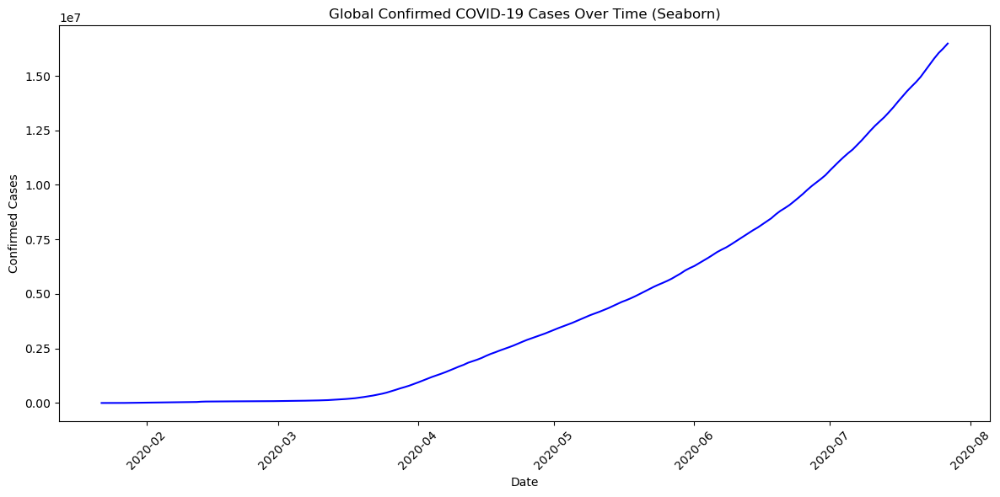

In [52]:
# Ensure 'Date' is datetime for sorting
data['Date'] = pd.to_datetime(data['Date'])

# Grouped data
trend_data = data.groupby('Date')['Confirmed'].sum().reset_index()

plt.figure(figsize=(12, 6))
sns.lineplot(data=trend_data, x='Date', y='Confirmed', color='blue')
plt.title('Global Confirmed COVID-19 Cases Over Time (Seaborn)')
plt.xlabel('Date')
plt.ylabel('Confirmed Cases')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


### Observation:
- The plot shows a **sharp exponential rise** in global confirmed COVID-19 cases from January to August 2020.
- Growth begins slowly, then **accelerates significantly from March 2020 onward**, indicating the rapid global spread.
- The steep and consistent upward trajectory highlights the **pandemic's intensification over time**, with no clear plateau during this period.


<a id=section82></a>
**8.2. Which countries have the highest number of confirmed cases?**

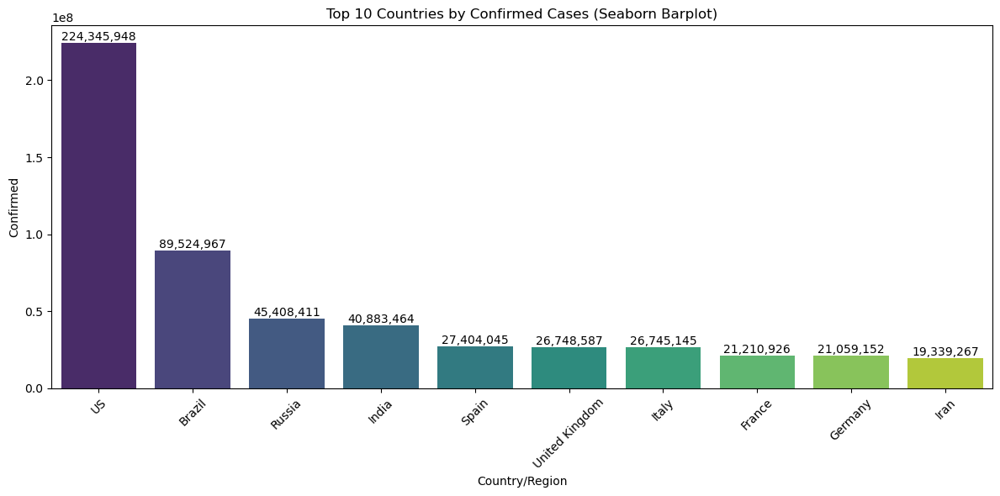

In [51]:
top_countries = data.groupby('Country/Region')['Confirmed'].sum().nlargest(10).reset_index()

plt.figure(figsize=(12, 6))
sns.barplot(data=top_countries, x='Country/Region', y='Confirmed', palette='viridis')
plt.title('Top 10 Countries by Confirmed Cases (Seaborn Barplot)')
plt.xticks(rotation=45)
for index, value in enumerate(top_countries['Confirmed']):
    plt.text(index, value, f'{value:,}', ha='center', va='bottom')
plt.tight_layout()
plt.show()


### Observation:

- The **United States** leads significantly with over **224 million confirmed COVID-19 cases**, far surpassing all other countries.
- **Brazil**, **Russia**, and **India** follow in descending order, each reporting tens of millions of cases.
- The chart highlights a **steep drop after the top three**, with the remaining countries showing relatively similar case counts between 19 and 27 million.


<a id=section83></a>
**8.3. What is the distribution of deaths across WHO regions?**

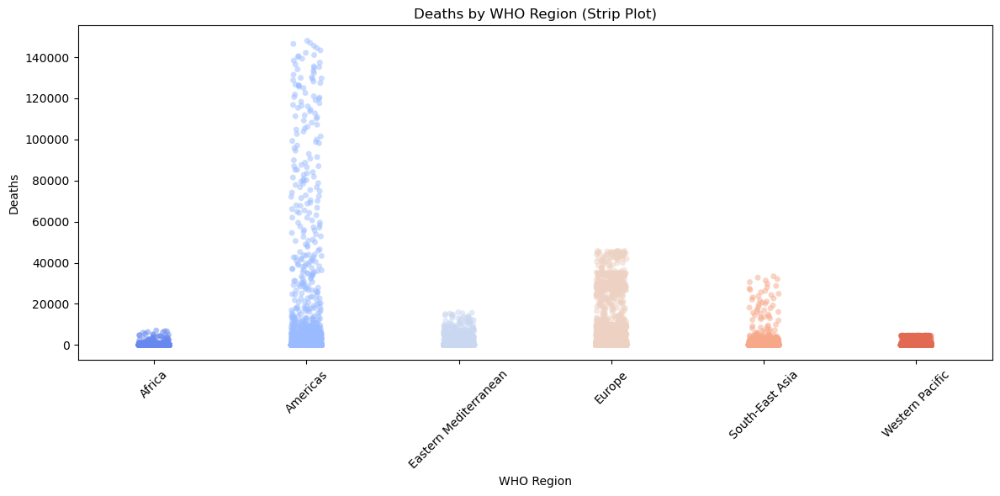

In [27]:
plt.figure(figsize=(12, 6))
sns.stripplot(x='WHO Region', y='Deaths', data=data, jitter=True, alpha=0.5, palette='coolwarm')
plt.title('Deaths by WHO Region (Strip Plot)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

### Observation:
- The **Americas** region exhibits the **widest and highest spread** of COVID-19 deaths, with several data points exceeding 100,000 deaths.
- **Europe** and the **Eastern Mediterranean** also show substantial death counts, though less extreme than the Americas.
- Regions like **Africa**, **South-East Asia**, and the **Western Pacific** show **comparatively lower death distributions**, indicating a less severe mortality impact or underreporting.



<a id=section84></a>
**8.4. How do recoveries compare across different countries?**

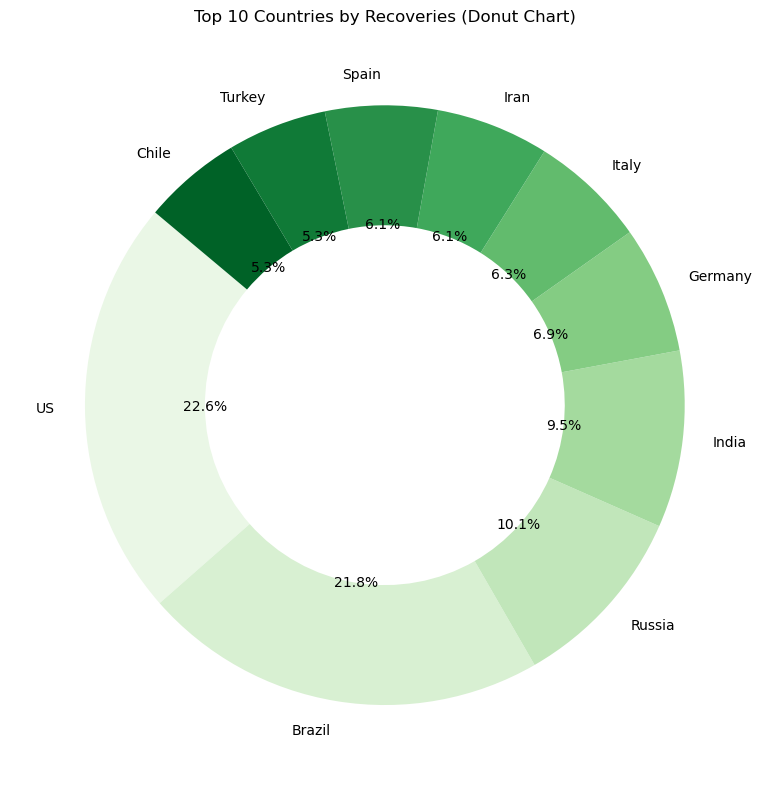

In [29]:
top_recovered = data.groupby('Country/Region')['Recovered'].sum().nlargest(10)
plt.figure(figsize=(8, 8))
plt.pie(top_recovered, labels=top_recovered.index, autopct='%1.1f%%', startangle=140, 
        wedgeprops={'width': 0.4}, colors=sns.color_palette('Greens', 10))
plt.title('Top 10 Countries by Recoveries (Donut Chart)')
plt.tight_layout()
plt.show()


### Observation:
- The **United States** and **Brazil** account for the highest shares of global COVID-19 recoveries, contributing **22.6%** and **21.8%** respectively among the top 10 countries.
- **Russia** and **India** follow with notable recovery contributions of **10.1%** and **9.5%**, highlighting effective patient management in these regions.
- Countries like **Germany**, **Italy**, **Iran**, **Spain**, **Turkey**, and **Chile** each contribute between **5.3% and 6.9%**, indicating a broader global distribution of successful recoveries.



<a id=section85></a>
**8.5. What is the trend of active cases over time globally?**

<Axes: title={'center': 'Global Active Cases Over Time'}, xlabel='Date'>

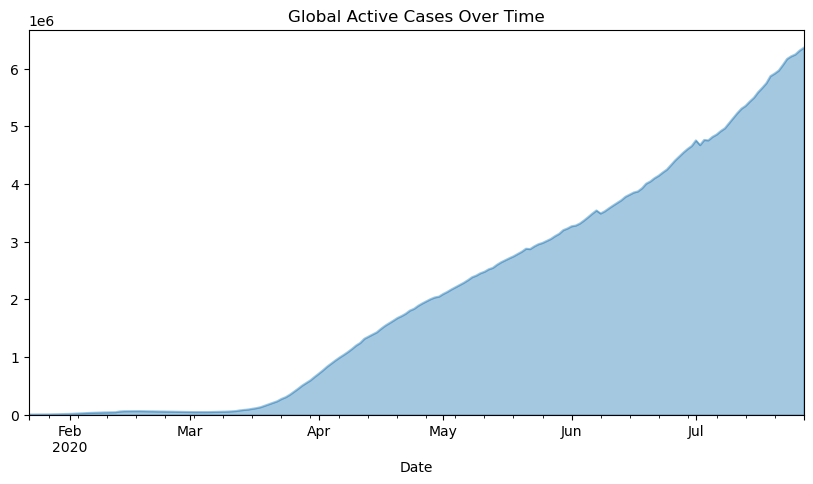

In [34]:
data.groupby('Date')['Active'].sum().plot(
    kind='area', alpha=0.4, 
    figsize=(10, 5), 
    title='Global Active Cases Over Time')

### Observation:

- The chart shows a **steady and consistent increase** in global active COVID-19 cases from February to late July 2020.
- The rise becomes **sharply exponential after March**, indicating widespread and accelerating transmission.
- Despite minor fluctuations, there is **no visible plateau**, highlighting sustained global spread during this period.



<a id=section86></a>
**8.6. What is the correlation between confirmed cases and deaths?**

<Axes: xlabel='Confirmed', ylabel='Deaths'>

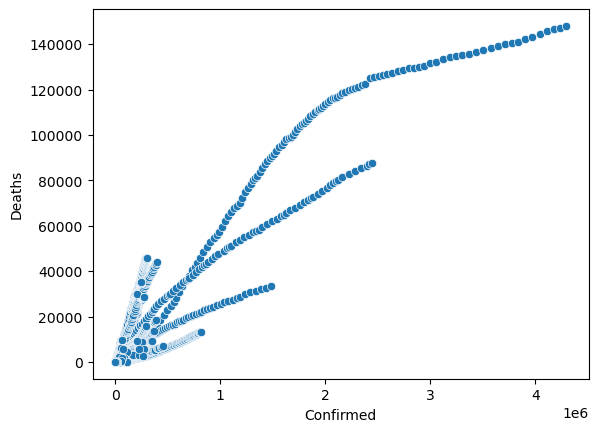

In [37]:
sns.scatterplot(x='Confirmed', y='Deaths', data=data)

### Observation:

- The scatter plot reveals a **strong positive correlation** between confirmed COVID-19 cases and reported deaths across countries or regions.
- The pattern suggests that as the number of confirmed cases increases, the **death toll also rises**, though the rate varies.
- Multiple upward curves indicate **distinct clusters**, possibly reflecting differences in healthcare quality, reporting standards, or population vulnerability.



<a id=section87></a>
**8.7. How do confirmed cases vary across WHO regions?**

In [50]:
import plotly.express as px

# Aggregate the data
confirmed_by_region = data.groupby('WHO Region')['Confirmed'].sum().reset_index()

# Plotly interactive bar chart
fig = px.bar(confirmed_by_region, 
             x='WHO Region', 
             y='Confirmed', 
             color='WHO Region',
             title='Total Confirmed Cases by WHO Region (Interactive)',
             hover_data={'Confirmed': ':.0f'})  # Show Confirmed with no decimals

fig.update_layout(xaxis_title='WHO Region',
                  yaxis_title='Total Confirmed Cases',
                  showlegend=False)  # Legend optional here since color is same as x

fig.show()


### Observation:

- The **Americas** region reported the **highest number of confirmed COVID-19 cases**, exceeding 400 million, making it the most affected WHO region.
- **Europe** follows with over 250 million confirmed cases, while the **Eastern Mediterranean** and **South-East Asia** show moderate case volumes.
- **Africa** and the **Western Pacific** have the **lowest case counts**, indicating either lower transmission, effective containment, or underreporting.



<a id=section88></a>
**8.8. What is the distribution of confirmed cases across countries?**

<Axes: title={'center': 'Distribution of Confirmed Cases'}, ylabel='Frequency'>

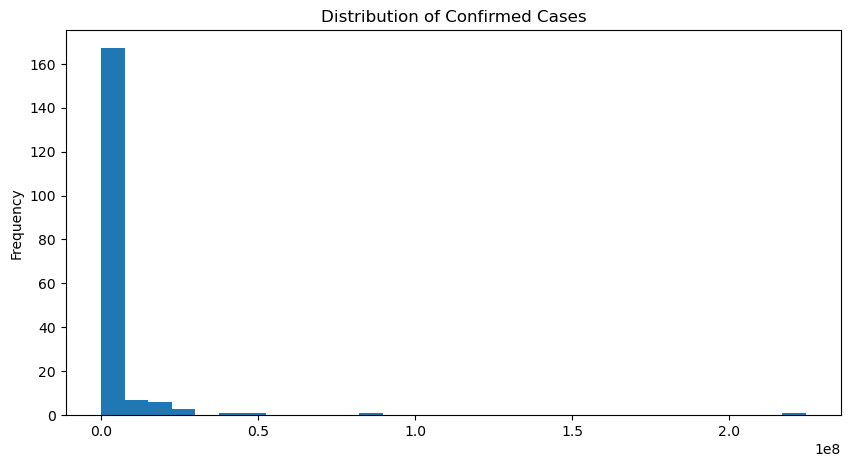

In [46]:
data.groupby('Country/Region')['Confirmed'].sum().plot(kind='hist', bins=30, figsize=(10, 5), title='Distribution of Confirmed Cases')


### Observation:
- The histogram shows a **highly right-skewed distribution** of confirmed COVID-19 cases across countries or regions.
- The **majority of locations have low case counts**, while a few countries report extremely high numbers, pulling the tail to the right.
- This skew indicates that the global case burden is **concentrated in a small number of countries**, highlighting disparity in the spread and scale of the pandemic.

<a id=section89></a>
**8.9. Which countries have the highest number of deaths?**

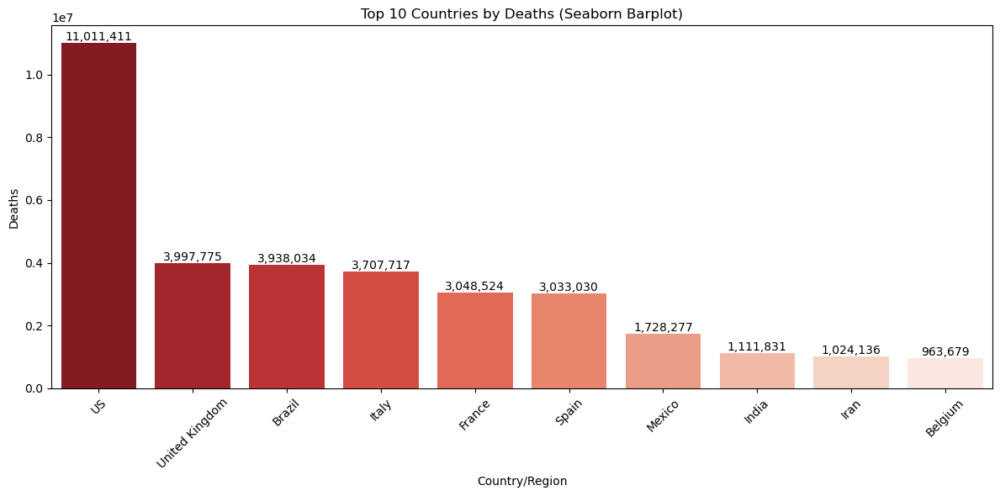

In [49]:
top_deaths = data.groupby('Country/Region')['Deaths'].sum().nlargest(10).reset_index()

plt.figure(figsize=(12, 6))
sns.barplot(data=top_deaths, x='Country/Region', y='Deaths', palette='Reds_r')
plt.title('Top 10 Countries by Deaths (Seaborn Barplot)')
plt.xticks(rotation=45)

# Add annotations
for index, value in enumerate(top_deaths['Deaths']):
    plt.text(index, value, f'{value:,}', ha='center', va='bottom')

plt.tight_layout()
plt.show()


### Observation:
- The **United States** reports the highest number of COVID-19 deaths, surpassing **11 million**, far ahead of all other countries.
- The **United Kingdom**, **Brazil**, **Italy**, and **France** form the next tier, each with **3 to 4 million deaths**, reflecting high pandemic severity.
- Countries like **Mexico**, **India**, **Iran**, and **Belgium** show lower but still substantial death tolls, indicating widespread global impact.

<a id=section810></a>
**8.10. What is the geographical distribution of confirmed cases?**

In [53]:
!pip install folium

In [55]:
import folium

# Load the dataset
data = pd.read_csv('covid_19_data.csv')
data['Province/State'].fillna('Not Available', inplace=True)

# Create the map
covid_map = folium.Map(location=[20, 0], zoom_start=2)

# Add markers with tooltips
for _, row in data.iterrows():
    if row['Confirmed'] > 0:
        folium.CircleMarker(
            location=[row['Lat'], row['Long']],
            radius=max(row['Confirmed'] / 100000, 1),
            color='blue',
            fill=True,
            fill_color='blue',
            fill_opacity=0.6,
            tooltip=f"{row['Country/Region']}, {row['Province/State']}: {row['Confirmed']} cases"
        ).add_to(covid_map)

# Display the map
covid_map

### Observation:

- The map visualization uses **bubble sizes to represent the number of COVID-19 cases** globally, with larger circles indicating higher case counts.
- The **United States, Brazil, and India** have the **largest bubbles**, clearly identifying them as the most affected countries.
- While **cases are distributed across all continents**, the concentration of large bubbles in **North and South America, Europe, and South Asia** highlights the most severely impacted regions.

<a id=section811></a>
**8.11. What is the trend of deaths over time globally?**

<Axes: title={'center': 'Global Deaths Over Time (Area Plot)'}, xlabel='Date'>

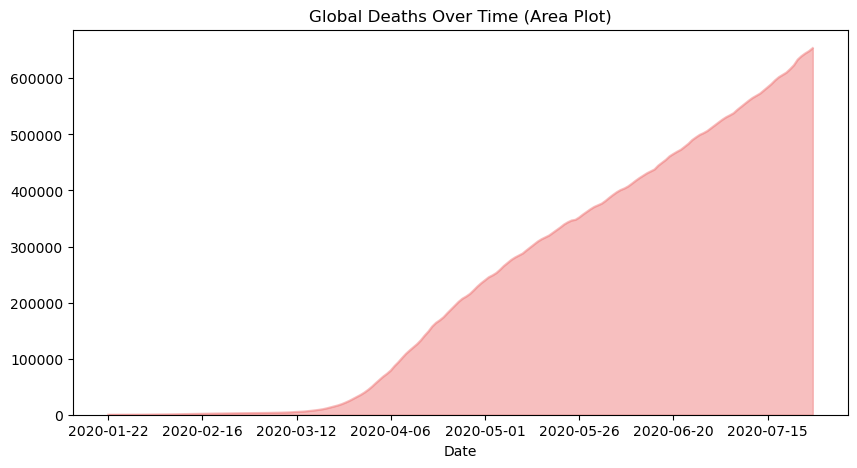

In [57]:
data.groupby('Date')['Deaths'].sum().plot(
    kind='area',
    color='lightcoral',
    alpha=0.5,
    figsize=(10, 5),
    title='Global Deaths Over Time (Area Plot)'
)

### Observation:
- The area plot illustrates a **steadily increasing global death toll** due to COVID-19 from January to mid-July 2020.
- There is a **noticeable acceleration in deaths** beginning around late March, reflecting the global surge in cases.
- The upward trend continues **without any plateau**, indicating that the pandemic was intensifying during this period with no sign of containment.

<a id=section812></a>
**8.12. How do active cases compare across countries?**

<Axes: title={'center': 'Top 10 Countries by Active Cases'}, xlabel='Country/Region'>

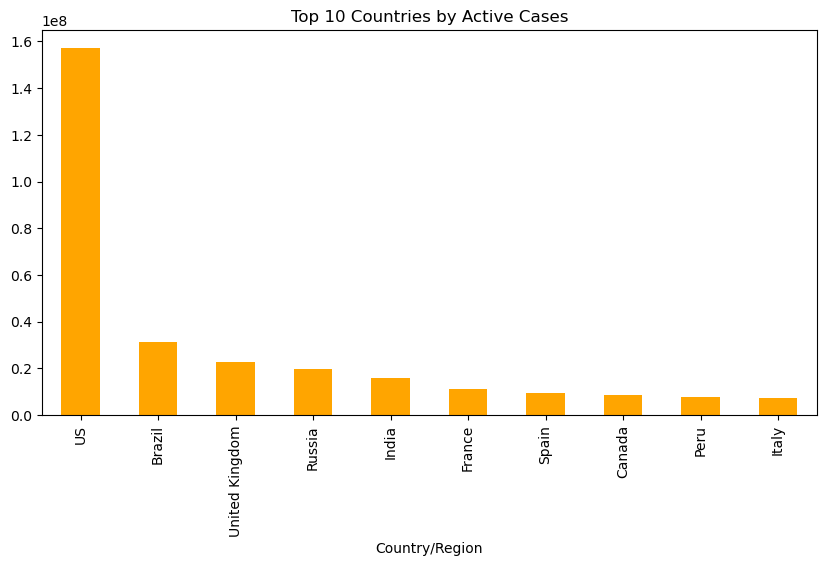

In [58]:
data.groupby('Country/Region')['Active'].sum().nlargest(10).plot(kind='bar', color='orange', figsize=(10, 5), title='Top 10 Countries by Active Cases')

### Observation:
- The **United States** leads significantly in active COVID-19 cases, with over **150 million**, far outpacing other countries in the top 10.
- **Brazil** and the **United Kingdom** follow, each with substantially lower active case counts, around the **20–30 million** range.
- Countries like **Russia**, **India**, **France**, and **Spain** show relatively similar levels, while **Canada**, **Peru**, and **Italy** complete the top 10 with lower but notable active cases.

---
<a name = Section9></a>
# **9. Summarization**
---

<a name = Section9.1></a>
### **9.1 Conclusion**

1. **Global Trend:** COVID-19 cases, deaths, and active cases showed a steep and sustained rise between early 2020 and mid-2020, with no signs of plateau in several countries and regions.
2. **Regional Disparity:** The **Americas and Europe** experienced the highest confirmed cases and death tolls, highlighting uneven pandemic impact across WHO regions.
3. **Country-Level Impact:** The **United States consistently ranked highest** in confirmed, active cases, and deaths, followed by Brazil, India, Russia, and several European countries.
4. **Death and Case Correlation:** A positive correlation exists between confirmed cases and deaths, although the death rate varies, indicating differences in healthcare systems and interventions.
5. **Distribution Skew:** Most countries reported relatively low case counts, but a small number of countries had **extremely high case volumes**, leading to a **highly right-skewed distribution**.
6. **Recovery Leaders:** The US and Brazil lead recoveries, but when adjusted for total cases, countries like **India and Russia show notable recovery efforts**.
7. **Geospatial Spread:** Bubble map visualization shows **dense and widespread infections**, with **case clusters centered around the US, Brazil, India, and parts of Europe and Asia**.

---

<a name = Section9.2></a>
### **9.2 Actionable Insights**

1. **Targeted Support for High-Burden Nations:** Strengthen **international aid, vaccine supply chains, and medical support** for countries with high active cases and death rates, especially the US, Brazil, and India.
2. **Improve Data Accuracy & Reporting:** Address underreporting in regions like **Africa and the Western Pacific** to ensure transparent, data-driven policymaking.
3. **Boost Recovery Strategies:** Analyze effective treatment protocols in **high-recovery countries** (like Russia and India) and consider **global sharing of medical best practices**.
4. **Invest in Healthcare Infrastructure:** Countries with high deaths relative to cases should **invest in healthcare capacity, oxygen support, ICU beds, and early intervention protocols**.
5. **Strengthen Regional Coordination:** WHO regions with high cumulative impact (Americas, Europe) should **enhance regional response mechanisms** including travel regulation, testing, and coordinated lockdowns.
6. **Prioritize Vaccination in Densely Populated Areas:** Focus immunization drives in **heavily affected urban centers** shown by large bubbles on the map.
7. **Public Awareness Campaigns:** For countries with sudden exponential trends, **launch aggressive public health communication**, emphasizing masking, social distancing, and vaccination.
8. **Predictive Surveillance:** Use data trends and EDA insights to **build predictive models** for anticipating future waves and allocating resources proactively.
9. **Custom Policies for Outliers:** Countries with exceptionally high or low metrics should have **customized containment and mitigation strategies** instead of one-size-fits-all global policies.
10. **Encourage Global Collaboration:** Promote **cross-border research and joint crisis response frameworks** to handle future pandemic outbreaks using lessons learned.
